In [1]:
import torch
import torch.nn as nn
from torchvision import models, transforms
import os
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import torch.optim as optim
import numpy as np

### Saliency maps

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = models.resnet18(pretrained=False)  

num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 10) 

checkpoint_path = "./Q2/network_visualization.pth"
model.load_state_dict(torch.load(checkpoint_path, map_location=device))

model.to(device)

model.eval()

/home2/poorvi.c/miniconda3/envs/research/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home2/poorvi.c/miniconda3/envs/research/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [4]:
def load_preprocess_data(img_no):
    class_names = ['arctic_fox', 'corgi', 'electric_ray', 'goldfish', 'hammerhead_shark',
                  'horse', 'hummingbird', 'indigo_finch', 'puma', 'red_panda']
    
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    base_path = "./Q2/network visualization"
    images = []
    labels = []
    image_paths = []
    
    for idx, class_name in enumerate(class_names):
        class_path = os.path.join(base_path, class_name.replace('_', ' '))
        image_file = os.listdir(class_path)[img_no] 
        image_path = os.path.join(class_path, image_file)
        
        image = Image.open(image_path).convert('RGB')
        image_tensor = transform(image)
        
        images.append(image_tensor)
        labels.append(idx)
        image_paths.append(image_path)
    
    return torch.stack(images), torch.tensor(labels), image_paths, class_names


In [5]:
def visualize_predictions(model, images, labels, image_paths, class_names, device):
    model.eval()
    
    with torch.no_grad():
        outputs = model(images.to(device))
        _, predicted = torch.max(outputs, 1)
    
    _, axes = plt.subplots(2, 5, figsize=(20, 8))
    
    for idx, ax in enumerate(axes.ravel()):
        ax.imshow(Image.open(image_paths[idx]))
        ax.axis('off')
        ax.set_title(f'GT: {class_names[labels[idx]]}\nPred: {class_names[predicted[idx]]}')
    
    plt.tight_layout()
    plt.show()

    return (predicted == labels.to(device)).sum().item() / len(labels)

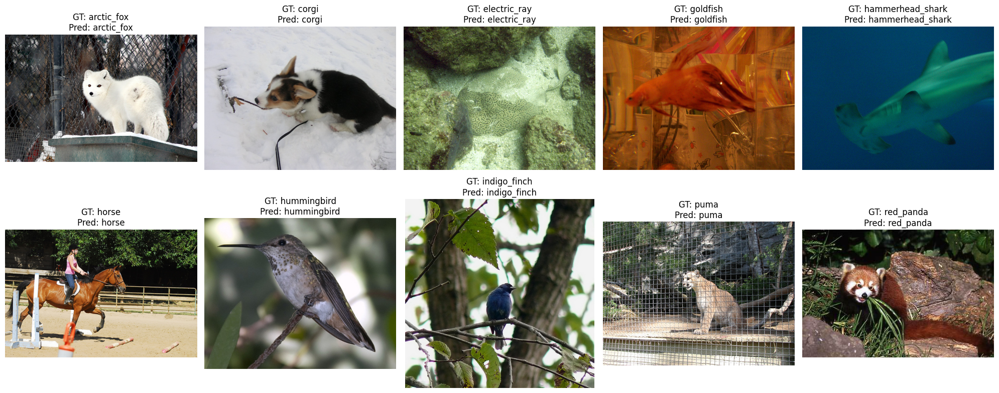

Accuracy 100.00%


In [ ]:
images, labels, image_paths, class_names = load_preprocess_data(2)
accuracy = visualize_predictions(model, images, labels, image_paths, class_names, device)
print(f"Accuracy {accuracy * 100:.2f}%")

In [7]:
def compute_saliency_maps(model, images, labels, device):
    images = images.to(device).requires_grad_(True)
    labels = labels.to(device)

    scores = model(images).gather(1, labels.view(-1, 1)).squeeze()
    
    model.zero_grad()
    scores.backward(torch.ones_like(scores))

    return images.grad.abs().max(dim=1)[0]

In [12]:
def visualize_saliency_results(images, labels, saliency_maps, class_names, image_paths):
    fig, axes = plt.subplots(10, 2, figsize=(10, 30))
    
    for idx in range(len(images)):
        img = Image.open(image_paths[idx])
        axes[idx, 0].imshow(img)
        axes[idx, 0].set_title(f'Original: {class_names[labels[idx]]}')
        axes[idx, 0].axis('off')
        
        axes[idx, 1].imshow(saliency_maps[idx].cpu(), cmap='hot')
        axes[idx, 1].set_title('Saliency Map')
        axes[idx, 1].axis('off')
    
    plt.tight_layout()
    plt.show()

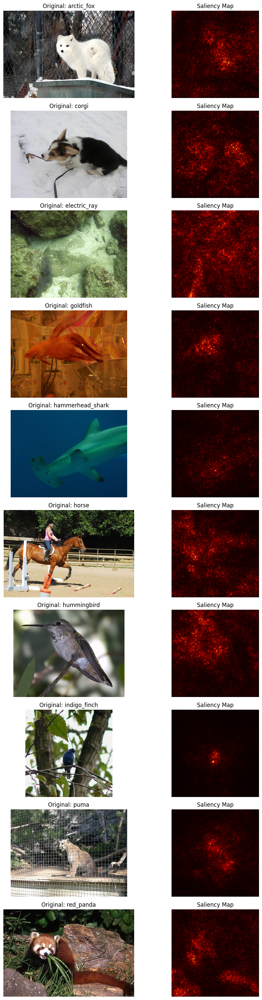

In [13]:
saliency_maps = compute_saliency_maps(model, images, labels, device)
visualize_saliency_results(images, labels, saliency_maps, class_names, image_paths)

In [65]:
def apply_saliency_masks(images, saliency_maps, threshold=0.5, noise_type='zero'):
    masked_images = []
    
    for img, saliency in zip(images, saliency_maps):
        img = img.to(device)
        saliency = saliency.to(device)

        norm_saliency = (saliency - saliency.min()) / (saliency.max() - saliency.min())
    
        mask = (saliency > threshold).float()
        
        if noise_type == 'zero':
            masked_img = img * mask.unsqueeze(0).repeat(3, 1, 1)
        else:  
            noise = torch.randn_like(img).to(device) * 0.1
            masked_img = torch.where(
                mask.unsqueeze(0).repeat(3, 1, 1) == 1,
                img,
                noise
            )
        
        masked_images.append(masked_img)
    
    return torch.stack(masked_images)

In [75]:
threshold = 0.007 
masked_images_zero = apply_saliency_masks(images, saliency_maps, threshold, 'zero')
masked_images_noise = apply_saliency_masks(images, saliency_maps, threshold, 'gaussian')

In [76]:
def analyze_classifications(model, original_images, masked_images_zero, 
                          masked_images_noise, labels, class_names, device):
    model.eval()
    with torch.no_grad():
        orig_outputs = model(original_images.to(device))
        zero_outputs = model(masked_images_zero.to(device))
        noise_outputs = model(masked_images_noise.to(device))
        
        _, orig_preds = torch.max(orig_outputs, 1)
        _, zero_preds = torch.max(zero_outputs, 1)
        _, noise_preds = torch.max(noise_outputs, 1)

        # print(zero_preds)
        # print(noise_preds)
    
    fig, axes = plt.subplots(10, 4, figsize=(20, 40))
    
    for idx in range(len(original_images)):
        axes[idx, 0].imshow(original_images[idx].permute(1,2,0).cpu())
        axes[idx, 0].set_title(f'Original\nPred: {class_names[orig_preds[idx]]}')
        
        axes[idx, 1].imshow(saliency_maps[idx].cpu(), cmap='hot')
        axes[idx, 1].set_title('Saliency Map')
        
        axes[idx, 2].imshow(masked_images_zero[idx].permute(1,2,0).cpu())
        axes[idx, 2].set_title(f'Zero-masked\nPred: {class_names[zero_preds[idx]]}')
        
        axes[idx, 3].imshow(masked_images_noise[idx].permute(1,2,0).cpu())
        axes[idx, 3].set_title(f'Noise-masked\nPred: {class_names[noise_preds[idx]]}')
        
        for ax in axes[idx]:
            ax.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    zero_conf = confusion_matrix(labels.cpu(), zero_preds.cpu())
    noise_conf = confusion_matrix(labels.cpu(), noise_preds.cpu())

    fig2, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))
    
    sns.heatmap(zero_conf, annot=True, fmt='d', ax=ax1)
    ax1.set_title('Zero-masked Confusion Matrix')
    ax1.set_xlabel('Predicted')
    ax1.set_ylabel('True')
    
    sns.heatmap(noise_conf, annot=True, fmt='d', ax=ax2)
    ax2.set_title('Noise-masked Confusion Matrix')
    ax2.set_xlabel('Predicted')
    ax2.set_ylabel('True')
    
    plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.0996952].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.5528543].
Cli

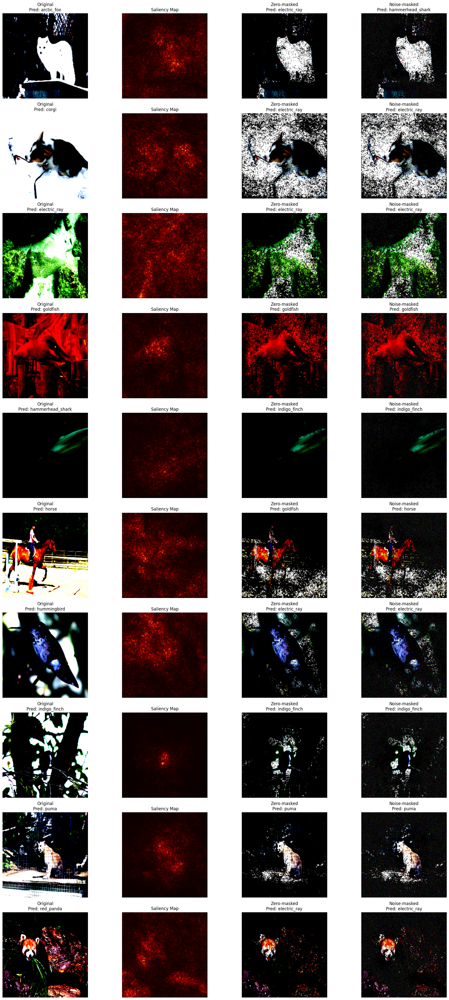

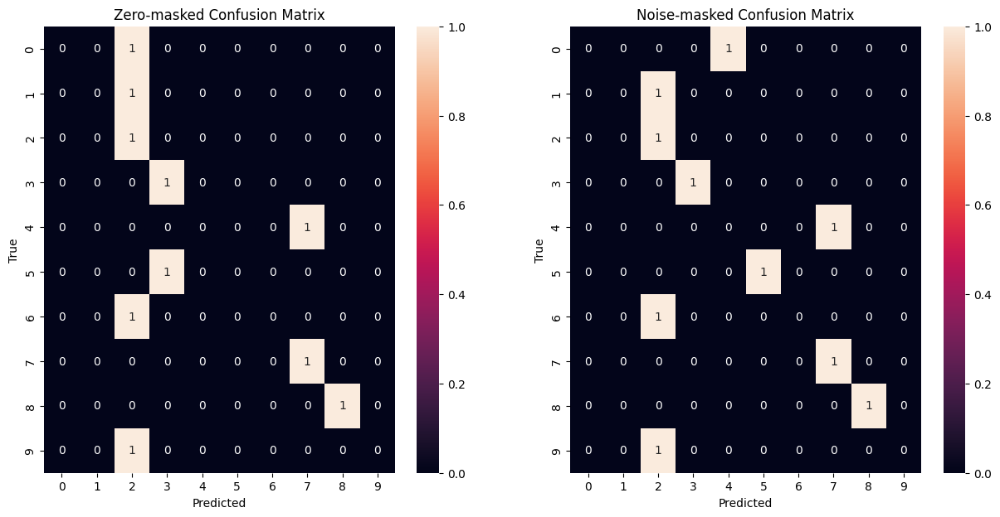

In [77]:
analyze_classifications(model, images, masked_images_zero, 
                                   masked_images_noise, labels, class_names, device)

- Brighter areas influence model predictions, while darker areas are less important.

- Removing non-salient pixels often changes predictions, showing reliance on background features.

- Gaussian noise disrupts structure, proving the model depends on overall image consistency.

- Misclassifications (e.g., "corgi" → "electric ray") suggest it leverages background textures.

- A high threshold removes too much data, increasing errors, while a balanced threshold preserves accuracy.

### Adverserial Attacks

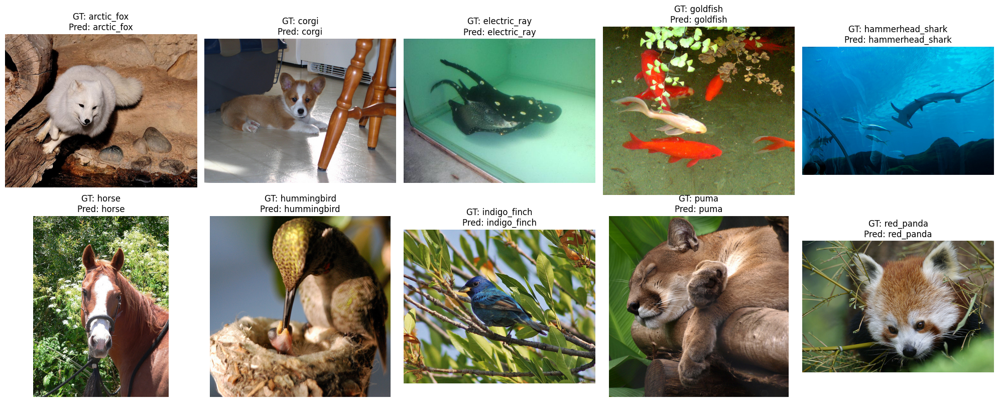

Accuracy 100.00%


In [8]:
images, labels, image_paths, class_names = load_preprocess_data(3)
accuracy = visualize_predictions(model, images, labels, image_paths, class_names, device)
print(f"Accuracy {accuracy * 100:.2f}%")

In [9]:
def add_gaussian_noise(image_tensor, mean=0, std=0.05):
    noise = torch.randn_like(image_tensor) * std + mean
    noisy_image = image_tensor + noise
    return torch.clamp(noisy_image, 0, 1)

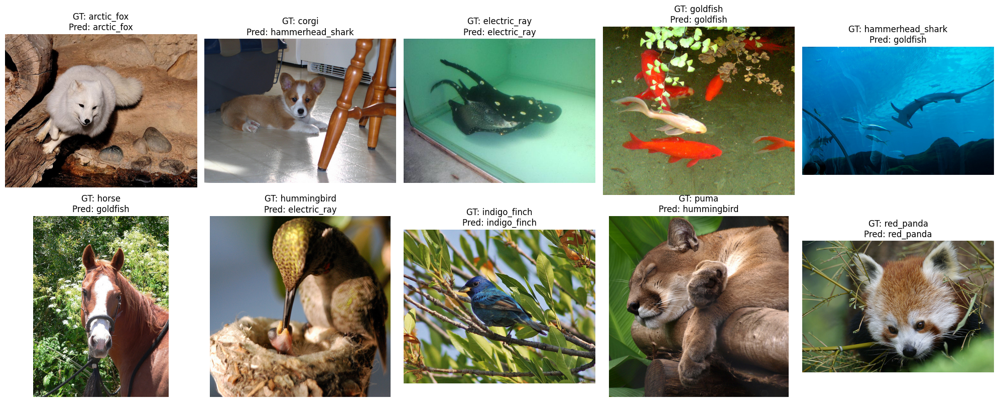

Accuracy with Gaussian noise (mean=0 and std=-0.05): 50.00%


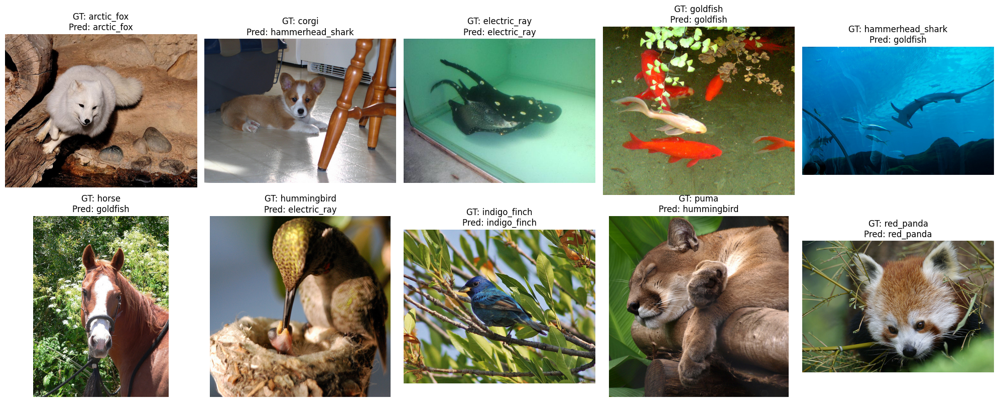

Accuracy with Gaussian noise (mean=0 and std=0.05): 50.00%


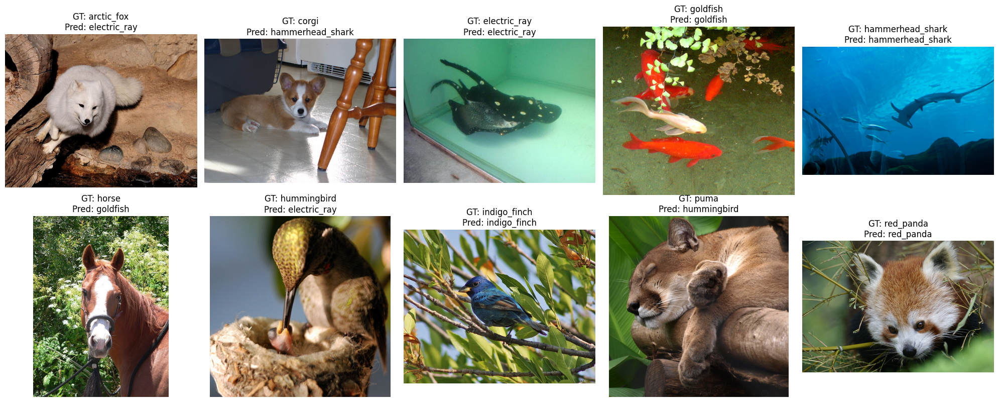

Accuracy with Gaussian noise (mean=0 and std=0.1): 50.00%


In [11]:
noises = [-0.05, 0.05, 0.1]
mean = 0

for noise_std in noises:
    images_noisy = torch.stack([add_gaussian_noise(img,mean=mean, std=noise_std) for img in images])
    accuracy_noisy = visualize_predictions(model, images_noisy, labels, image_paths, class_names, device)
    print(f"Accuracy with Gaussian noise (mean={mean} and std={noise_std}): {accuracy_noisy * 100:.2f}%")

In [12]:
def optimize_image(model, image_tensor, original_label, target_class, num_epochs=300, lr=0.01):
    image = image.clone().detach().to(device).requires_grad_(True)
    
    for param in model.parameters():
        param.requires_grad_(False)
    
    optimizer = optim.Adam([image], lr=lr)
    loss_fn = nn.CrossEntropyLoss()

    for epoch in range(num_epochs):
        optimizer.zero_grad()
        output = model(image.unsqueeze(0))  
        loss = -output[0, target_class]  

        loss.backward()
        optimizer.step()
        image.data.clamp_(0, 1)  

        if epoch % 50 == 0:
            print(f"Epoch {epoch}/{num_epochs}, Loss: {loss.item():.4f}")

    return image.detach()


In [31]:
img_set = 3
images, labels, image_paths, class_names = load_preprocess_data(img_set)

image_tensor = images[9].to(device)
true_label = labels[9].item()

model.eval()
with torch.no_grad():
    probs = torch.softmax(model(image_tensor.unsqueeze(0)), dim=1)[0]

sorted_classes = probs.argsort(descending=True)
target_class_a, target_class_b = sorted_classes[1].item(), sorted_classes[-1].item()

In [32]:
print(sorted_classes)

tensor([9, 0, 6, 1, 8, 7, 3, 2, 4, 5], device='cuda:0')


In [33]:
target_class_b

5

In [34]:
target_class_a

0

In [50]:
print("\nOptimizing for next highest probability class...")
adv_image_a = optimize_image(model, image_tensor, true_label, target_class_a, num_epochs=100)


Optimizing for next highest probability class...
Epoch 0/100, Loss: 1.9253
Epoch 50/100, Loss: -41.5102


In [51]:
print("\nOptimizing for lowest probability class...")
adv_image_b = optimize_image(model, image_tensor, true_label, target_class_b, num_epochs=100)


Optimizing for lowest probability class...
Epoch 0/100, Loss: 6.1961
Epoch 50/100, Loss: -33.2263


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3611329].


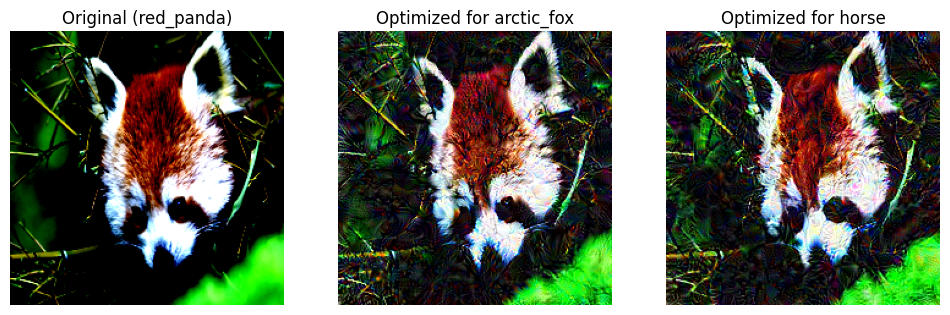

In [52]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(image_tensor.cpu().permute(1, 2, 0))
plt.title(f"Original ({class_names[true_label]})")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(adv_image_a.cpu().permute(1, 2, 0))
plt.title(f"Optimized for {class_names[target_class_a]}")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(adv_image_b.cpu().permute(1, 2, 0))
plt.title(f"Optimized for {class_names[target_class_b]}")
plt.axis("off")

plt.show()

Does the image still visually appear the same? Yes

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3611329].


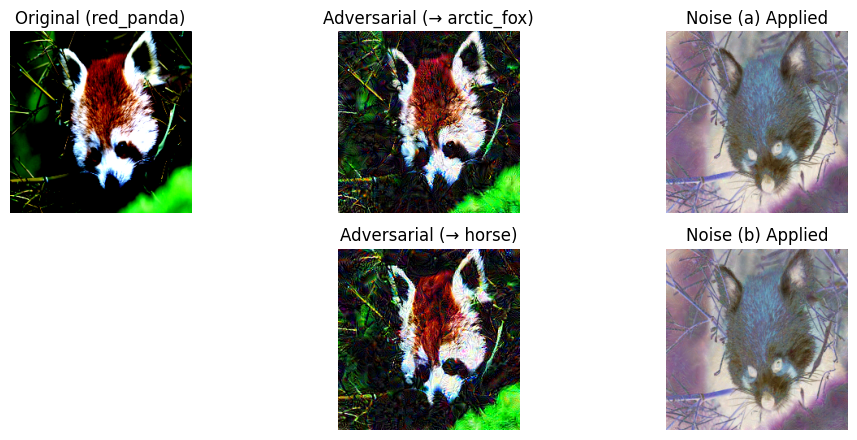

In [53]:
def normalize_noise(noise):
    return (noise - noise.min()) / noise.max()

noise_a, noise_b = adv_image_a - image_tensor, adv_image_b - image_tensor
noise_a_vis, noise_b_vis = normalize_noise(noise_a), normalize_noise(noise_b)

fig, axes = plt.subplots(2, 3, figsize=(12, 8))

images = [
    (image_tensor, f"Original ({class_names[true_label]})"),
    (adv_image_a, f"Adversarial (→ {class_names[target_class_a]})"),
    (noise_a_vis, "Noise (a) Applied"),
    (adv_image_b, f"Adversarial (→ {class_names[target_class_b]})"),
    (noise_b_vis, "Noise (b) Applied")
]

for ax, (img, title) in zip(axes.flat, images):
    ax.imshow(img.cpu().permute(1, 2, 0))
    ax.set_title(title)
    ax.axis("off")

plt.tight_layout()
plt.show()


- The red panda image is misclassified as an arctic fox and a horse, with subtle texture changes in fur patterns.

- Both noise maps highlight key regions modified, showing distinct patterns that contribute to misclassification.

-  Noise (a) has a bluish-gray tint, while noise (b) introduces more varied colors and textures.

-  Despite adversarial perturbations, the images retain the overall red panda shape, affecting only fine-grained details.

-  Both adversarial attacks effectively fool the model, proving its vulnerability to small but structured pixel changes.